In [1]:
import pandas as pd
import gensim
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import xgboost as xgb
# Tokenizing the words
from nltk.tokenize import word_tokenize
# Filter out stopwords
from nltk.corpus import stopwords
# tSNE
from sklearn.manifold import TSNE
# To show text on tSNE cluster graph
from adjustText import adjust_text
import h2o

In [3]:
# Set options for pandas
##########PERSONAL notebook consideration##############
# Wont go into Prodcution

def start():
    options = {
        'display': {
            'max_columns': None,
            'max_colwidth': 25,
            'expand_frame_repr': False,  # Don't wrap to multiple pages
            'max_rows': 14,
            'max_seq_items': 50,         # Max length of printed sequence
            'precision': 4,
            'show_dimensions': True
        },
        'mode': {
            'chained_assignment': None   # Controls SettingWithCopyWarning
        }
    }

    for category, option in options.items():
        for op, value in option.items():
            pd.set_option(f'{category}.{op}', value)

start()

In [4]:
amazon_data = pd.read_csv(r'F:\RA_Squark\Prod_testing\DAT\AmazonReviews.Small.csv')

In [5]:
amazon_data.head()

,ProductId,UserId,Summary,Score,HelpfulnessDenominator,Id,ProfileName,HelpfulnessNumerator,Time,Text
0,B00141QYSQ,A1YS02UZZGRDCT,Do Not Buy,1,2,41471,Evan Eberhardt,2,1348358400,These are made in Chi...
1,B0089SPEO2,A3JOYNYL458QHP,Less lemon and less zing,3,0,28582,coleridge,0,1323907200,"Everything is ok, exc..."
2,B001PMCDK2,A14TTMM0Z03Y2W,my cat goes crazy for...,5,0,389965,Lindsay S. Bradford,0,1310601600,Best cat treat ever. ...
3,B002Q8JOSI,A17UQD2RSSQH5X,My dogs tell me these...,5,1,212536,in the dark,1,1316131200,My two Corgis were th...
4,B00176G870,A2F2MZW8EOGH5J,Yummy to the tummy,5,0,115971,"daemoncycler ""When yo...",0,1334793600,We used to have drive...


In [6]:
# Grab all the article titles
amazon_text = amazon_data['Text']
amazon_text.shape

(55554,)

In [7]:
# Create a list of strings, where each string is an article title
text_list = [text for text in amazon_text]
text_list

["These are made in China (do not buy ANY pet food from China).  Dogswell has been using propylene glycol to soften their treats (what are they thinkng?).  Do not purchase or support this company in any way until they clean up their act.  And for whatever reason Amazon doesn't allow returns of this item, so I had to toss mine out.  Bad business all around on this one.",
 "Everything is ok, except it just isn't as good as it is in the bags.  Just considerably more bland -- less lemon and less zing.  Boring.",
 "Best cat treat ever. There isn't anything comparable to the love my cat has for these treats, he snubs away any other kind now.<br />I know he likes to manipulate me with his cattiness but these treats are my way of manipulating him to come sit on my lap and have some chill time. :)",
 'My two Corgis were thoroughly spoiled by my late husband (I spent a year and a half dieting them down a combined total of 25 pounds!)<br /><br />They are accustomed to the finest of fare, and they

In [8]:
# Collapse the list of strings into a single long string for processing
long_text = ' '.join(text_list)
long_text

'These are made in China (do not buy ANY pet food from China).  Dogswell has been using propylene glycol to soften their treats (what are they thinkng?).  Do not purchase or support this company in any way until they clean up their act.  And for whatever reason Amazon doesn\'t allow returns of this item, so I had to toss mine out.  Bad business all around on this one. Everything is ok, except it just isn\'t as good as it is in the bags.  Just considerably more bland -- less lemon and less zing.  Boring. Best cat treat ever. There isn\'t anything comparable to the love my cat has for these treats, he snubs away any other kind now.<br />I know he likes to manipulate me with his cattiness but these treats are my way of manipulating him to come sit on my lap and have some chill time. :) My two Corgis were thoroughly spoiled by my late husband (I spent a year and a half dieting them down a combined total of 25 pounds!)<br /><br />They are accustomed to the finest of fare, and they absolutel

In [9]:
# Tokenize the string into words
tokens = word_tokenize(long_text)
tokens[:10]

['These', 'are', 'made', 'in', 'China', '(', 'do', 'not', 'buy', 'ANY']

In [10]:
# Remove non-alphabetic tokens, such as punctuation
words = [text.lower() for text in tokens if text.isalpha()]
words

['these',
 'are',
 'made',
 'in',
 'china',
 'do',
 'not',
 'buy',
 'any',
 'pet',
 'food',
 'from',
 'china',
 'dogswell',
 'has',
 'been',
 'using',
 'propylene',
 'glycol',
 'to',
 'soften',
 'their',
 'treats',
 'what',
 'are',
 'they',
 'thinkng',
 'do',
 'not',
 'purchase',
 'or',
 'support',
 'this',
 'company',
 'in',
 'any',
 'way',
 'until',
 'they',
 'clean',
 'up',
 'their',
 'act',
 'and',
 'for',
 'whatever',
 'reason',
 'amazon',
 'does',
 'allow',
 'returns',
 'of',
 'this',
 'item',
 'so',
 'i',
 'had',
 'to',
 'toss',
 'mine',
 'out',
 'bad',
 'business',
 'all',
 'around',
 'on',
 'this',
 'one',
 'everything',
 'is',
 'ok',
 'except',
 'it',
 'just',
 'is',
 'as',
 'good',
 'as',
 'it',
 'is',
 'in',
 'the',
 'bags',
 'just',
 'considerably',
 'more',
 'bland',
 'less',
 'lemon',
 'and',
 'less',
 'zing',
 'boring',
 'best',
 'cat',
 'treat',
 'ever',
 'there',
 'is',
 'anything',
 'comparable',
 'to',
 'the',
 'love',
 'my',
 'cat',
 'has',
 'for',
 'these',
 'trea

In [11]:
# Real set of words (with stopwords)
len(words)

4371507

In [12]:
stop_words = set(stopwords.words('english'))
stop_words

{'a',
 'about',
 'above',
 'after',
 'again',
 'against',
 'ain',
 'all',
 'am',
 'an',
 'and',
 'any',
 'are',
 'aren',
 "aren't",
 'as',
 'at',
 'be',
 'because',
 'been',
 'before',
 'being',
 'below',
 'between',
 'both',
 'but',
 'by',
 'can',
 'couldn',
 "couldn't",
 'd',
 'did',
 'didn',
 "didn't",
 'do',
 'does',
 'doesn',
 "doesn't",
 'doing',
 'don',
 "don't",
 'down',
 'during',
 'each',
 'few',
 'for',
 'from',
 'further',
 'had',
 'hadn',
 "hadn't",
 'has',
 'hasn',
 "hasn't",
 'have',
 'haven',
 "haven't",
 'having',
 'he',
 'her',
 'here',
 'hers',
 'herself',
 'him',
 'himself',
 'his',
 'how',
 'i',
 'if',
 'in',
 'into',
 'is',
 'isn',
 "isn't",
 'it',
 "it's",
 'its',
 'itself',
 'just',
 'll',
 'm',
 'ma',
 'me',
 'mightn',
 "mightn't",
 'more',
 'most',
 'mustn',
 "mustn't",
 'my',
 'myself',
 'needn',
 "needn't",
 'no',
 'nor',
 'not',
 'now',
 'o',
 'of',
 'off',
 'on',
 'once',
 'only',
 'or',
 'other',
 'our',
 'ours',
 'ourselves',
 'out',
 'over',
 'own',
 'r

In [13]:
words = [word for word in words if not word in stop_words]
# Print first 10 words
words[:10]

['made',
 'china',
 'buy',
 'pet',
 'food',
 'china',
 'dogswell',
 'using',
 'propylene',
 'glycol']

In [14]:
# Reduced set of words (removed stopwords)
len(words)

2180207

In [15]:
# Load Word2Vec model (trained on an enormous Google corpus)
model = gensim.models.KeyedVectors.load_word2vec_format(r'F:\RA_Squark\wrord2vec_other_libraries\Trained Model\GoogleNews-vectors-negative300.bin', binary = True) 

# Check dimension of word vectors
model.vector_size

300

In [16]:
# Filter the list of vectors to include only those that Word2Vec has a vector for
vector_list = [model[word] for word in words if word in model.vocab]
vector_list

[array([-5.59082031e-02,  1.17675781e-01,  2.10937500e-01,  8.36181641e-03,
         7.27539062e-02, -3.12500000e-01, -2.91748047e-02,  1.13677979e-03,
         3.16406250e-01,  7.37304688e-02,  5.12695312e-03, -1.58203125e-01,
        -1.50390625e-01,  2.27539062e-01,  1.03027344e-01, -8.15429688e-02,
         2.46093750e-01,  3.07617188e-02,  4.37011719e-02,  1.78710938e-01,
        -7.22656250e-02,  1.10839844e-01,  7.51953125e-02,  1.25976562e-01,
        -1.10473633e-02, -2.06054688e-01, -2.04101562e-01,  4.12597656e-02,
        -1.35742188e-01,  1.80664062e-01,  1.58203125e-01, -1.23046875e-01,
         1.06201172e-02,  3.78417969e-02,  2.07519531e-02,  1.42669678e-03,
         1.34765625e-01,  6.83593750e-02,  1.04003906e-01, -1.96533203e-02,
         9.37500000e-02, -6.54296875e-02,  1.44531250e-01, -1.14257812e-01,
         2.50000000e-01, -9.03320312e-02, -4.98046875e-02, -4.63867188e-02,
        -2.90527344e-02, -1.84570312e-01,  7.47070312e-02, -4.41894531e-02,
         1.1

In [17]:
# Create a list of the words corresponding to these vectors
words_filtered = [word for word in words if word in model.vocab]
words_filtered

['made',
 'china',
 'buy',
 'pet',
 'food',
 'china',
 'using',
 'propylene',
 'glycol',
 'soften',
 'treats',
 'purchase',
 'support',
 'company',
 'way',
 'clean',
 'act',
 'whatever',
 'reason',
 'amazon',
 'allow',
 'returns',
 'item',
 'toss',
 'mine',
 'bad',
 'business',
 'around',
 'one',
 'everything',
 'ok',
 'except',
 'good',
 'bags',
 'considerably',
 'bland',
 'less',
 'lemon',
 'less',
 'zing',
 'boring',
 'best',
 'cat',
 'treat',
 'ever',
 'anything',
 'comparable',
 'love',
 'cat',
 'treats',
 'snubs',
 'away',
 'kind',
 'br',
 'know',
 'likes',
 'manipulate',
 'cattiness',
 'treats',
 'way',
 'manipulating',
 'come',
 'sit',
 'lap',
 'chill',
 'time',
 'two',
 'corgis',
 'thoroughly',
 'spoiled',
 'late',
 'husband',
 'spent',
 'year',
 'half',
 'dieting',
 'combined',
 'total',
 'pounds',
 'br',
 'br',
 'accustomed',
 'finest',
 'fare',
 'absolutely',
 'love',
 'wellness',
 'brand',
 'treats',
 'used',
 'drive',
 'specialty',
 'pet',
 'food',
 'store',
 'product',
 

In [18]:
print("Redcued by STOPWORDS: "+ str(len(words)))
print("Reduced by Vocab: "+ str(len(words_filtered)))

Redcued by STOPWORDS: 2180207
Reduced by Vocab: 2147664


In [19]:
# Zip the words together with their vector representations
word_vec_zip = zip(words_filtered, vector_list)
word_vec_zip

In [20]:
# Cast to a dict so we can turn it into a dataframe
word_vec_dict = dict(word_vec_zip)
word_vec_dict

{'made': array([-5.59082031e-02,  1.17675781e-01,  2.10937500e-01,  8.36181641e-03,
         7.27539062e-02, -3.12500000e-01, -2.91748047e-02,  1.13677979e-03,
         3.16406250e-01,  7.37304688e-02,  5.12695312e-03, -1.58203125e-01,
        -1.50390625e-01,  2.27539062e-01,  1.03027344e-01, -8.15429688e-02,
         2.46093750e-01,  3.07617188e-02,  4.37011719e-02,  1.78710938e-01,
        -7.22656250e-02,  1.10839844e-01,  7.51953125e-02,  1.25976562e-01,
        -1.10473633e-02, -2.06054688e-01, -2.04101562e-01,  4.12597656e-02,
        -1.35742188e-01,  1.80664062e-01,  1.58203125e-01, -1.23046875e-01,
         1.06201172e-02,  3.78417969e-02,  2.07519531e-02,  1.42669678e-03,
         1.34765625e-01,  6.83593750e-02,  1.04003906e-01, -1.96533203e-02,
         9.37500000e-02, -6.54296875e-02,  1.44531250e-01, -1.14257812e-01,
         2.50000000e-01, -9.03320312e-02, -4.98046875e-02, -4.63867188e-02,
        -2.90527344e-02, -1.84570312e-01,  7.47070312e-02, -4.41894531e-02,
    

In [21]:
df = pd.DataFrame.from_dict(word_vec_dict, orient='index')
df.shape

(29808, 300)

In [22]:
type(df)

pandas.core.frame.DataFrame

In [23]:
df.head(3)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
made,-0.0559,0.1177,0.2109,0.0084,0.0728,-0.3125,-0.0292,0.0011,0.3164,0.0737,0.0051,-0.1582,-0.1504,0.2275,0.1030,-0.0815,0.2461,0.0308,0.0437,0.1787,-0.0723,0.1108,0.0752,0.1260,-0.0110,-0.2061,-0.2041,0.0413,-0.1357,0.1807,0.1582,-0.1230,0.0106,0.0378,0.0208,0.0014,0.1348,0.0684,0.1040,-0.0197,0.0938,-0.0654,0.1445,-0.1143,0.2500,-0.0903,-0.0498,-0.0464,-0.0291,-0.1846,0.0747,-0.0442,0.0110,-0.0806,-0.1650,0.2500,-0.0309,-0.0664,-0.0084,0.0250,-0.1533,0.2227,0.0889,-0.1406,-0.1895,0.0908,-0.0820,0.2090,-0.0469,-0.0222,0.0297,-0.0625,-0.1309,-0.0032,-0.1699,0.0082,0.2139,0.1357,-0.0092,0.0052,0.0535,-0.2383,0.0625,-0.1523,0.0923,-0.2061,0.1738,0.0337,0.0869,0.0310,0.1670,0.0242,0.1045,0.1040,-0.0325,-0.3262,-0.1982,0.0688,0.2168,0.0505,0.1230,0.0124,-0.106,0.1943,-0.0781,-0.0513,0.0933,-0.0630,-0.0640,-0.0557,-0.2217,-0.0099,0.0547,0.1270,0.1182,-0.0137,0.1562,0.0022,0.0796,0.0757,0.0693,0.2207,0.0283,0.2139,-0.0791,-0.0918,0.0562,-0.1611,0.0060,-0.1172,-0.1807,-0.1787,-0.0342,0.2061,-0.0167,-0.0261,-0.0820,-0.0294,-0.0684,-0.1221,0.0422,-0.0635,0.0074,-0.0400,-0.0182,0.3574,0.1494,-0.1338,0.0486,0.1562,0.0393,-0.0742,0.0110,-0.1099,-0.0479,0.0015,0.0197,0.0388,0.0029,-0.0869,-0.0099,-0.0085,0.0491,-0.0747,-0.0013,-0.1992,-0.0072,0.1226,0.2168,-0.0352,-0.0625,-0.0200,-0.0148,-0.2275,-0.0933,-0.0718,-0.0674,-0.0879,0.0388,0.1328,0.0850,-0.1514,0.0525,0.1729,-0.1699,-0.1328,-0.2363,-0.0781,-0.0962,-0.1299,0.2021,-0.1196,0.0449,-0.0010,-0.2656,0.1196,0.0479,-0.1348,-0.2402,-0.0713,0.1357,-0.1152,-0.0977,0.1328,0.0309,-0.1221,5.5075e-05,0.0057,0.1865,0.0356,-0.0117,0.0601,0.1328,0.1035,-0.0027,0.0369,0.1699,0.1396,-0.0447,0.0605,0.1270,0.1069,-0.1445,0.0168,0.1079,0.0493,-0.1318,-0.0106,-0.0942,0.0204,0.2793,-0.0087,0.1592,-0.0620,0.1118,-0.1167,0.2041,-0.1719,-0.0376,-0.0574,0.0299,0.0535,0.0133,0.1128,0.2871,-0.0383,-0.0198,-0.0184,-0.0042,-0.1631,0.0713,0.0525,0.2891,0.1211,0.2373,0.1128,0.1553,0.1738,-0.1152,-0.1367,-0.0762,0.0503,0.1050,-0.1504,0.1748,-0.0320,0.0513,-0.2793,-0.0099,-0.2109,0.2285,0.1196,0.0208,-0.0049,0.2246,0.0337,-0.1572,-0.0352,0.0762,-0.0933,0.0084,-0.1162,-0.0923,0.1279,-0.1182,0.1074,-0.0210,-0.1260,0.0176,0.0216,-0.2695,-0.0625,-0.1338,-0.0192,-0.1167,-0.0408,0.1338,-0.0427,0.1475,-0.1826
china,-0.2949,0.0845,0.0103,0.3457,-0.0938,0.0554,0.1318,-0.2734,-0.1182,0.3125,-0.2969,-0.3691,0.1006,-0.1797,-0.1689,0.1128,-0.1226,0.2754,-0.2158,-0.4531,0.0947,-0.1611,0.3203,-0.3281,0.1738,0.5977,-0.2207,0.1934,-0.0447,-0.0625,-0.1348,-0.1079,-0.3145,-0.0515,-0.0962,-0.1562,-0.2383,0.0161,0.0061,0.0820,-0.0679,0.1631,0.2041,-0.0884,0.2051,0.1465,-0.0430,0.2070,-0.2344,-0.1050,0.1113,0.2002,-0.0474,0.0728,-0.2910,0.1562,-0.1963,-0.0762,0.1670,-0.2656,-0.0786,0.1445,-0.2451,-0.1172,-0.2559,0.2197,-0.2129,-0.1631,-0.0041,0.1289,0.4375,0.0962,0.0283,-0.0479,-0.1187,-0.0918,-0.2129,0.2197,-0.0952,-0.1787,0.0014,-0.2676,0.0767,-0.2012,0.1328,0.158

In [24]:
# df=df.rename(columns={1:"Vec1"})

In [25]:
# h2o.H2OFrame(df)

In [26]:
# Initialize t-SNE
tsne = TSNE(n_components = 2, init = 'random', random_state = 10, perplexity = 100)
tsne

TSNE(angle=0.5, early_exaggeration=12.0, init='random', learning_rate=200.0,
   method='barnes_hut', metric='euclidean', min_grad_norm=1e-07,
   n_components=2, n_iter=1000, n_iter_without_progress=300,
   perplexity=100, random_state=10, verbose=0)

In [27]:
# Use only 400 rows to shorten processing time
tsne_df = tsne.fit_transform(df[:400])
tsne_df

array([[-1.1946505 , -0.13151199],
       [-2.3610516 ,  2.5967536 ],
       [ 0.66419256, -1.2543662 ],
       [-5.5823774 ,  0.47661597],
       [ 0.9706509 ,  2.1551845 ],
       [-0.7298851 ,  0.34421784],
       [ 0.7325367 , -2.0215316 ],
       [ 0.860991  ,  0.28306195],
       [-4.078673  , -1.1986057 ],
       [-1.3717794 ,  2.3228843 ],
       [ 0.6429952 , -1.2549515 ],
       [-1.0354425 , -0.46406814],
       [-0.16903901, -0.48636088],
       [-1.8818728 , -0.04804029],
       [-3.1105692 , -0.59792167],
       [-1.4962665 ,  0.5086923 ],
       [-2.3328807 ,  0.32253277],
       [-2.7486053 , -0.4152309 ],
       [-3.0991266 ,  2.79531   ],
       [-1.1063062 ,  0.61808914],
       [-2.6624148 , -1.8858511 ],
       [ 0.09772553, -0.8788205 ],
       [-4.2663054 , -1.7122118 ],
       [-3.8513193 , -2.3936641 ],
       [-3.4028652 ,  0.11413986],
       [-0.28154024, -0.39836743],
       [-1.6554837 , -0.5181923 ],
       [-1.5979997 , -0.42014426],
       [-2.5154176 ,

In [28]:
len(tsne_df)

400

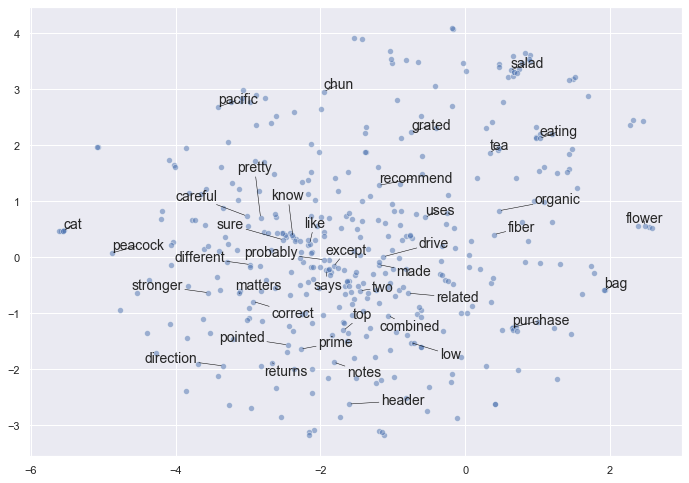

In [29]:
sns.set()

fig, ax = plt.subplots(figsize = (11.7, 8.27))
sns.scatterplot(tsne_df[:, 0], tsne_df[:, 1], alpha = 0.5)

# Second plot: Import adjustText, initialize list of texts
texts = []
words_to_plot = list(np.arange(0, 400, 10))

# Append words to list
for word in words_to_plot:
    texts.append(plt.text(tsne_df[word, 0], tsne_df[word, 1], df.index[word], fontsize = 14))

# Plot text using adjust_text (because overlapping text is hard to read)
adjust_text(texts, force_points = 0.4, force_text = 0.4, 
            expand_points = (2,1), expand_text = (1,2), 
            arrowprops = dict(arrowstyle = "-", color = 'black', lw = 0.5))

plt.show()

In [30]:
import h2o

In [31]:
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 ..... not found.
Attempting to start a local H2O server...
; OpenJDK 64-Bit Server VM (build 25.152-b12, mixed mode)56-b12)
  Starting server from C:\Users\prabh\Anaconda3\lib\site-packages\h2o\backend\bin\h2o.jar
  Ice root: C:\Users\prabh\AppData\Local\Temp\tmpvkiijib4
  JVM stdout: C:\Users\prabh\AppData\Local\Temp\tmpvkiijib4\h2o_prabh_started_from_python.out
  JVM stderr: C:\Users\prabh\AppData\Local\Temp\tmpvkiijib4\h2o_prabh_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O cluster uptime:,03 secs
H2O cluster timezone:,America/New_York
H2O data parsing timezone:,UTC
H2O cluster version:,3.24.0.3
H2O cluster version age:,6 months and 11 days !!!
H2O cluster name:,H2O_from_python_prabh_mmd5ik
H2O cluster total nodes:,1
H2O cluster free memory:,3.512 Gb
H2O cluster total cores:,12
H2O cluster allowed cores:,12
H2O cluster status:,"accepting new members, healthy"


In [32]:
# amazon_review=h2o.import_file(r'F:\RA_Squark\Prod_testing\DAT\AmazonReviews.Small.csv')

In [33]:
# amazon_review.head(3)

In [34]:
type(df)

pandas.core.frame.DataFrame

In [35]:
df_h2o=h2o.H2OFrame(df)

H2OTypeError: Argument `column_names` should be a ?list(string), got list [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299]

In [ ]:
# Clean HTML and tags present in text to avoid H2O -> pandas conversion
def clean_html(df):
    arr=df.columns
    for col in arr:
        print(col)
        if str(df[col].types.values())=="dict_values(['string'])" or str(df[col].types.values())=="dict_values(['enum'])":
            print('Removing the HTML tags: {}'.format(col))
            try:
                df[col]=df[col].gsub("<br />", ' ', ignore_case=True)
                df[col]=df[col].gsub("\n", ' ', ignore_case=True)
                df[col]=df[col].gsub("<", ' ', ignore_case=True)
                df[col]=df[col].gsub("/>", ' ', ignore_case=True)
                df[col]=df[col].gsub(", ", '', ignore_case=True)
                df[col]=df[col].gsub("/a>", ' ', ignore_case=True)
                df[col]=df[col].gsub('"' , '', ignore_case=True)
            except:
                pass
    return df

In [ ]:
amazon_review=clean_html(amazon_review)

In [ ]:
amazon_review_pd=amazon_review.as_data_frame()

In [ ]:
df.to_csv('./DAT/df.csv')

In [ ]:
df_h2o=h2o.import_file('./DAT/df.csv', header=1 )
df_h2o.head(3)

In [ ]:
amazon_review.cbind(df_h2o)